SISU 2017

In [1]:
#%matplotlib notebook
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from matplotlib import colors 
from matplotlib.ticker import PercentFormatter 
import seaborn as sns
import datetime
from datetime import date
from collections import Counter
import scipy.stats as stats
import json

pd.set_option("display.precision", 13)

In [2]:
def getDOB(data_a_converter):
    if data_a_converter.year > 2017:
       data_a_converter = data_a_converter.replace(year=data_a_converter.year-100)
    return data_a_converter

In [3]:
def getAge(data_nasc):
    if(data_nasc == 0):
        return 0
    data_limite = date(2016, 12, 31)
    idade = data_limite.year - data_nasc.year - ((data_limite.month, data_limite.day) < (data_nasc.month, data_nasc.day))
    return idade

Para melhor uso de recursos computacionais, realizamos uma etapa de pré-processamento. Nessa etapa, convertemos o arquivo CSV para Parquet, um tipo de arquivo mais adequado para lidar com grandes volumes de dados em ciência de dados. Com isso, conseguimos reduzir o tamanho do arquivo e o  tempo de leitura e escrita.

In [4]:
df_chamada_regular_1 = pd.read_parquet("ListagemChamadaRegular_2017-1.parquet", engine="fastparquet")
df_chamada_regular_2 = pd.read_parquet("ListagemChamadaRegular_2017-2.parquet", engine="fastparquet")

In [5]:
def getDigits(codigo):
    codigo = str(codigo)
    return codigo[:3] + codigo[12 - 3:]

● Empilhar na mesma base de dados as linhas das listas de chamada regular 1 e 2

● Compatibilizar nomes e formato das variáveis nas duas listas de chamada

In [6]:
df_chamada_regular_2.rename(columns={'ï»¿NU_ANO': 'NU_ANO'}, inplace=True)

In [7]:
df_chamada_regular_1 = df_chamada_regular_1.drop(['DS_ETAPA'], axis=1)

In [8]:
df_chamada_regular_2 = df_chamada_regular_2.drop(['DS_ETAPA', 'ST_MATRICULA'], axis=1)

In [9]:
df_chamada_regular_1['LISTAGEM'] = 1
df_chamada_regular_2['LISTAGEM'] = 2

In [10]:
df_sisu = pd.concat([df_chamada_regular_1, df_chamada_regular_2])

● Ajustar a grafia das variáveis de nome e sigla da instituição, para que todas as instituições que possuírem o mesmo código de IES possuam o mesmo nome e sigla também (padronizar escrita)

In [11]:
dicionario_ies = {}
update_dictionary = lambda row: dicionario_ies.update({row['CO_IES']: (row['NO_IES'], row['SIGLA_IES'])}) if row['CO_IES'] not in dicionario_ies else None
df_sisu[df_sisu['LISTAGEM'] == 1].apply(update_dictionary, axis=1)
df_sisu[df_sisu['LISTAGEM'] == 2].apply(update_dictionary, axis=1)
dicionario_ies[1811] = ('INSTITUTO FEDERAL DE EDUCAÇÃO, CIÊNCIA E TECNOLOGIA DE GOIÁS', 'IFG')

In [12]:
df_sisu['NO_IES'] = df_sisu['CO_IES'].apply(lambda x: dicionario_ies.get(x, (df_sisu['NO_IES'], df_sisu['SIGLA_IES']))[0])
df_sisu['SIGLA_IES'] = df_sisu['CO_IES'].apply(lambda x: dicionario_ies.get(x, (df_sisu['NO_IES'], df_sisu['SIGLA_IES']))[1])

● Ajustar a grafia das variáveis de nome do campus, para que todas as observações que possuírem o mesmo código de campus possuam o mesmo nome também (padronizar escrita)

In [13]:
dicionario_campus = dict(zip(df_chamada_regular_1['CO_CAMPUS'], df_chamada_regular_1['NO_CAMPUS']))
df_sisu['NO_CAMPUS'] = df_sisu['CO_CAMPUS'].map(dicionario_campus)

● Ajustar a grafia das variáveis de nome do curso de graduação, para que todas as observações que possuírem o mesmo código possuam o mesmo nome também (padronizar escrita)

In [14]:
dicionario_cursos = dict(zip(df_chamada_regular_1['CO_IES_CURSO'], df_chamada_regular_1['NO_CURSO']))
df_sisu['NO_CURSO'] = df_sisu['CO_IES_CURSO'].map(dicionario_cursos)

In [15]:
df_sisu['DATA_NASCIMENTO_CONVERTIDA'] = pd.to_datetime(df_sisu['DT_NASCIMENTO'], dayfirst=True, format='mixed', errors = 'coerce')

In [16]:
df_sisu['DATA_NASCIMENTO_CONVERTIDA'] = df_sisu['DATA_NASCIMENTO_CONVERTIDA'].apply(getDOB)

In [17]:
df_sisu['DATA_NASCIMENTO_CONVERTIDA'] = pd.to_datetime(df_sisu['DATA_NASCIMENTO_CONVERTIDA']).dt.date

In [18]:
df_sisu['DATA_NASCIMENTO_CONVERTIDA'] = df_sisu['DATA_NASCIMENTO_CONVERTIDA'].fillna(0)
df_sisu['IDADE'] = df_sisu['DATA_NASCIMENTO_CONVERTIDA'].apply(getAge)


In [19]:
df_sisu.drop(df_sisu.loc[df_sisu['IDADE'] < 10].index, inplace=True)

In [20]:
with open("teste.json", "r", encoding='utf8') as arquivo:
    course_dict = json.load(arquivo)

In [21]:
df_sisu['CD_CLASSIFICACAO'] = df_sisu['NO_CURSO'].apply(lambda curso: course_dict.get(curso, 99))

In [22]:
classificacao_dict = {
    1: ["Programas gerais", "Programa básico"],
    8: ["Programas gerais", "Literacia e numeracia"],
    9: ["Programas gerais", "Desenvolvimento pessoal"],
    14: ["Educação", "Treinamento de professores e ciência educacional"],
    21: ["Humanidades e artes", "Artes"],
    22: ["Humanidades e artes", "Humanidades"],
    31: ["Ciências sociais, negócios e direito", "Ciência social e comportamental"],
    32: ["Ciências sociais, negócios e direito", "Jornalismo e informação"],
    34: ["Ciências sociais, negócios e direito", "Negócios e administração"],
    38: ["Ciências sociais, negócios e direito", "Direito"],
    42: ["Ciência", "Ciências da vida"],
    44: ["Ciência", "Ciências físicas"],
    46: ["Ciência", "Matemática e estatística"],
    48: ["Ciência", "Computação"],
    52: ["Engenharia, manufatura e construção", "Engenharia e ofícios"],
    54: ["Engenharia, manufatura e construção", "Manufatura e processamento"],
    58: ["Engenharia, manufatura e construção", "Arquitetura e construção"],
    62: ["Agricultura", "Agricultura, silvicultura e pesca"],
    64: ["Agricultura", "Veterinária"],
    72: ["Saúde e bem-estar", "Saúde"],
    76: ["Saúde e bem-estar", "Serviços sociais"],
    81: ["Serviços", "Serviços pessoais"],
    84: ["Serviços", "Serviços de transporte"],
    85: ["Serviços", "Proteção ambiental"],
    86: ["Serviços", "Serviços de segurança"],
    99: ["Não especificado", "Não especificado"]
}

In [23]:
df_sisu['AREA_GERAL'] = df_sisu['CD_CLASSIFICACAO'].map(lambda x: classificacao_dict[x][0])

In [24]:
df_sisu['AREA_GERAL'] = df_sisu['CD_CLASSIFICACAO'].map(lambda x: classificacao_dict[x][0] if x in classificacao_dict else None)

# Calculando a contagem de gênero por área geral
df_counts = df_sisu.groupby(['AREA_GERAL', 'TP_SEXO']).size().unstack(fill_value=0)

# Calculando a porcentagem de cada gênero em relação ao total por área geral
df_percentages = df_counts.div(df_counts.sum(axis=1), axis=0) * 100

# Arredondando as porcentagens para 2 casas decimais
df_percentages = df_percentages.round(2)

# Resetando o índice para ter um DataFrame plano
df_percentages = df_percentages.reset_index()

# Exibindo o novo DataFrame
print(df_percentages)

TP_SEXO                            AREA_GERAL      F      M
0                                 Agricultura  58.84  41.16
1                                     Ciência  44.56  55.44
2        Ciências sociais, negócios e direito  59.01  40.99
3                                    Educação  82.47  17.53
4         Engenharia, manufatura e construção  39.75  60.25
5                         Humanidades e artes  61.06  38.94
6                            Não especificado  59.12  40.88
7                           Saúde e bem-estar  74.83  25.17
8                                    Serviços  53.18  46.82


In [25]:
df_sisu['AREA_GERAL'] = df_sisu['CD_CLASSIFICACAO'].map(lambda x: classificacao_dict[x][0] if x in classificacao_dict else None)

# Filtrando apenas o gênero feminino (TP_SEXO = "F")
df_female = df_sisu[df_sisu['TP_SEXO'] == 'F']

# Calculando a porcentagem do gênero feminino por área geral
df_percentages = df_female.groupby('AREA_GERAL').size() / len(df_female) * 100

# Criando um novo DataFrame
df_result = pd.DataFrame({'AREA_GERAL': df_percentages.index, 'PORCENTAGEM_FEMININO': df_percentages.values})

# Arredondando as porcentagens para 2 casas decimais
df_result['PORCENTAGEM_FEMININO'] = df_result['PORCENTAGEM_FEMININO'].round(2)

# Exibindo o novo DataFrame
print(df_result)

                             AREA_GERAL  PORCENTAGEM_FEMININO
0                           Agricultura                  5.19
1                               Ciência                 13.01
2  Ciências sociais, negócios e direito                 22.24
3                              Educação                  6.29
4   Engenharia, manufatura e construção                  9.76
5                   Humanidades e artes                  8.94
6                      Não especificado                  5.10
7                     Saúde e bem-estar                 22.95
8                              Serviços                  6.53


In [26]:
df_sisu['AREA_GERAL'] = df_sisu['CD_CLASSIFICACAO'].map(lambda x: classificacao_dict[x][0] if x in classificacao_dict else None)

# Filtrando apenas o gênero masculino (TP_SEXO = "M")
df_male = df_sisu[df_sisu['TP_SEXO'] == 'M']

# Calculando a porcentagem do gênero masculino por área geral
df_percentages = df_male.groupby('AREA_GERAL').size() / len(df_male) * 100

# Criando um novo DataFrame
df_result = pd.DataFrame({'AREA_GERAL': df_percentages.index, 'PORCENTAGEM_MASCULINO': df_percentages.values})

# Arredondando as porcentagens para 2 casas decimais
df_result['PORCENTAGEM_MASCULINO'] = df_result['PORCENTAGEM_MASCULINO'].round(2)

# Exibindo o novo DataFrame
print(df_result)

                             AREA_GERAL  PORCENTAGEM_MASCULINO
0                           Agricultura                   4.90
1                               Ciência                  21.85
2  Ciências sociais, negócios e direito                  20.85
3                              Educação                   1.81
4   Engenharia, manufatura e construção                  19.96
5                   Humanidades e artes                   7.69
6                      Não especificado                   4.76
7                     Saúde e bem-estar                  10.42
8                              Serviços                   7.76


In [27]:
df_sisu['CD_CLASSIFICACAO'].value_counts()

CD_CLASSIFICACAO
72    1075366
52     798412
34     674099
22     412397
81     389827
48     377277
44     351090
99     330416
38     326381
31     294178
14     292159
42     234196
64     179862
62     157677
46     155527
32     148199
21     147995
76      98987
58      95166
85      73001
54      46318
84       4092
86       3270
Name: count, dtype: int64

In [28]:
#Rever daqui pra baixo

In [29]:
df_sisu['NOTAS_CONCATENADAS'] = df_sisu[['NU_NOTA_L', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_M', 'NU_NOTA_R']].apply(lambda row: ' '.join(row.astype(np.float64).values.astype(str)), axis=1)

In [30]:
df_sisu.columns

Index(['NU_ANO', 'NU_EDICAO', 'CO_ETAPA', 'CO_IES', 'NO_IES', 'SIGLA_IES',
       'SG_UF_IES', 'CO_CAMPUS', 'NO_CAMPUS', 'SG_UF_CAMPUS',
       'NO_MUNUCIPIO_CAMPUS', 'CO_IES_CURSO', 'NO_CURSO', 'DS_GRAU',
       'DS_TURNO', 'TP_MOD_CONCORRENCIA', 'DS_MOD_CONCORRENCIA',
       'NU_PERCENTUAL_BONUS', 'NU_PESO_L', 'NU_PESO_CH', 'NU_PESO_CN',
       'NU_PESO_M', 'NU_PESO_R', 'NOTA_MINIMA_L', 'NOTA_MINIMA_CH',
       'NOTA_MINIMA_CN', 'NOTA_MINIMA_M', 'NOTA_MINIMA_R', 'MEDIA_MINIMA',
       'NU_CPF', 'CO_INSCRICAO_ENEM', 'NO_INSCRITO', 'TP_SEXO',
       'DT_NASCIMENTO', 'SG_UF_CANDIDATO', 'MUNICIPIO_CANDIDATO', 'ST_OPCAO',
       'NU_NOTA_L', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_M', 'NU_NOTA_R',
       'NOTA_L_COM_PESO', 'NOTA_CH_COM_PESO', 'NOTA_CN_COM_PESO',
       'NOTA_M_COM_PESO', 'NOTA_R_COM_PESO', 'NU_NOTA_CANDIDATO',
       'NU_NOTACORTE', 'NU_CLASSIFICACAO', 'ST_APROVADO', 'LISTAGEM',
       'DATA_NASCIMENTO_CONVERTIDA', 'IDADE', 'CD_CLASSIFICACAO', 'AREA_GERAL',
       'NOTAS_CON

● Criar variável identificador único de cada candidato usando as variáveis que identificam esse candidato (nome, idade e estado) conjuntamente

In [31]:
df_sisu["IDENTIFICADORES_CONCATENADOS"] = df_sisu[["NOTAS_CONCATENADAS", "IDADE", "SG_UF_CANDIDATO", "TP_SEXO"]].apply(lambda row: ' '.join(row.values.astype(str)), axis=1)

In [32]:
colunas_desejadas = ["NO_INSCRITO", "IDENTIFICADORES_CONCATENADOS", "NOTAS_CONCATENADAS", "IDADE", "SG_UF_CANDIDATO", "TP_SEXO", "ST_APROVADO", 'NU_NOTA_L', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_M', 'NU_NOTA_R', "LISTAGEM"]
subset_df = df_sisu[colunas_desejadas]
df_unicos = subset_df.groupby("IDENTIFICADORES_CONCATENADOS").agg({
    "NO_INSCRITO": "last",
    "NOTAS_CONCATENADAS": "last",
    "IDADE": "last",
    "SG_UF_CANDIDATO": "last",
    "TP_SEXO": "last", 
    "ST_APROVADO": list, 
    "LISTAGEM": list,
    "NU_NOTA_L": "last",
    "NU_NOTA_CH": "last",
    "NU_NOTA_CN": "last",
    "NU_NOTA_M": "last",
    "NU_NOTA_R": "last"
}).reset_index()
df_unicos.drop_duplicates(subset="IDENTIFICADORES_CONCATENADOS", keep="last", inplace=True)

In [33]:
print(df_sisu["IDENTIFICADORES_CONCATENADOS"].value_counts())

IDENTIFICADORES_CONCATENADOS
542.9000244140625 560.4000244140625 521.9000244140625 671.5 780.0 17 CE M                  4
550.4000244140625 605.5999755859375 518.2000122070312 424.0 560.0 20 CE M                  4
532.0999755859375 553.5 546.0 396.20001220703125 640.0 24 RJ F                             4
556.7000122070312 589.7000122070312 502.0 614.4000244140625 560.0 26 ES M                  4
609.7999877929688 636.5999755859375 577.5 555.2999877929688 720.0 30 MG F                  4
                                                                                          ..
562.7999877929688 514.4000244140625 503.3999938964844 459.29998779296875 520.0 29 BA F     1
523.7000122070312 578.7000122070312 484.70001220703125 451.1000061035156 560.0 16 SC M     1
539.9000244140625 470.29998779296875 490.79998779296875 436.6000061035156 580.0 24 DF M    1
444.3999938964844 514.0 408.29998779296875 414.79998779296875 520.0 23 GO M                1
501.29998779296875 367.3999938964844 413.

○ Tabular número de observações que possuem valores duplicados para esse identificador único/chave

○ Tabular quantidade de duplicados em cada listagem regular (1 ou 2)

In [34]:
listagem_1 = df_sisu["IDENTIFICADORES_CONCATENADOS"][df_sisu["LISTAGEM"] == 1]
listagem_2 = df_sisu["IDENTIFICADORES_CONCATENADOS"][df_sisu["LISTAGEM"] == 2]

In [35]:
total_inscricoes = len(df_sisu)
total_inscricoes_listagem_1 = len(df_sisu[df_sisu['LISTAGEM'] == 1])
total_inscricoes_listagem_2 = len(df_sisu[df_sisu['LISTAGEM'] == 2])

total_inscritos_listagem_1 = len(listagem_1.value_counts().index)
total_inscritos_listagem_2 = len(listagem_2.value_counts().index)
total_inscritos = total_inscritos_listagem_1 + total_inscritos_listagem_2

df_total_inscricoes_e_inscritos = pd.DataFrame({"Listagem": ["1", "2", "Total"],
                                   "Quantidade de inscrições": [total_inscricoes_listagem_1, total_inscricoes_listagem_2, total_inscricoes],
                                   "Quantidade de inscritos": [total_inscritos_listagem_1, total_inscritos_listagem_2, total_inscritos]})
df_total_inscricoes_e_inscritos_formatado = df_total_inscricoes_e_inscritos.style.set_caption("Quantidade de inscrições e inscritos por listagem")
df_total_inscricoes_e_inscritos_formatado.hide()
display(df_total_inscricoes_e_inscritos_formatado)   

Listagem,Quantidade de inscrições,Quantidade de inscritos
1,4868545,2494173
2,1797347,935538
Total,6665892,3429711


In [36]:
frequencia_inscrito_curso_listagem_1 = Counter(listagem_1.value_counts().values)
frequencia_inscrito_curso_listagem_2 = Counter(listagem_2.value_counts().values)

inscrito_1_curso = frequencia_inscrito_curso_listagem_1.get(1) + frequencia_inscrito_curso_listagem_2.get(1)
inscrito_2_cursos = frequencia_inscrito_curso_listagem_1.get(2) + frequencia_inscrito_curso_listagem_2.get(2)
total_inscrito_cursos = inscrito_1_curso + inscrito_2_cursos

df_inscritos_cursos = pd.DataFrame({"Opção de curso": ["Apenas 1 curso", "2 cursos", "Total"],
                                   "Quantidade de inscritos": [inscrito_1_curso, inscrito_2_cursos, total_inscrito_cursos]})
df_inscritos_cursos_formatado = df_inscritos_cursos.style.set_caption("Distribuição de inscritos segundo as opções de cursos")
df_inscritos_cursos_formatado.hide()
display(df_inscritos_cursos_formatado) 

Opção de curso,Quantidade de inscritos
Apenas 1 curso,193530
2 cursos,3236181
Total,3429711


In [37]:
caso_apenas_listagem_1 = df_unicos[(df_unicos['LISTAGEM'].apply(lambda x: x.count(1) > 0)) & (df_unicos['LISTAGEM'].apply(lambda x: x.count(2) == 0))].shape[0]
caso_apenas_listagem_2 = df_unicos[(df_unicos['LISTAGEM'].apply(lambda x: x.count(2) > 0)) & (df_unicos['LISTAGEM'].apply(lambda x: x.count(1) == 0))].shape[0]
caso_ambas_listagens = df_unicos[(df_unicos['LISTAGEM'].apply(lambda x: x.count(1) > 0)) & (df_unicos['LISTAGEM'].apply(lambda x: x.count(2) > 0))].shape[0]
total_casos = caso_apenas_listagem_1 + caso_apenas_listagem_2 + caso_ambas_listagens

df_casos_inscritos = pd.DataFrame({"Caso": ["Realizou inscrição apenas na listagem 1", "Realizou inscrição apenas na listagem 2", "Realizou inscrição em ambas as listagens", "Total"],
                                   "Quantidade de inscritos": [caso_apenas_listagem_1, caso_apenas_listagem_2, caso_ambas_listagens, total_casos]})
df_casos_inscritos_formatado = df_casos_inscritos.style.set_caption("Distribuição dos inscritos segundo casos de inscrição")
df_casos_inscritos_formatado.hide()
display(df_casos_inscritos_formatado)

Caso,Quantidade de inscritos
Realizou inscrição apenas na listagem 1,1689691
Realizou inscrição apenas na listagem 2,131056
Realizou inscrição em ambas as listagens,804482
Total,2625229


● Criar um identificador único que indique observações que possuam exatamente a mesma nota em todas as disciplinas (Ciências da Natureza, Ciências Humanas, Linguagens e Códigos, Matemática, Redação)

In [38]:
contagem_frequencia = Counter(df_sisu["IDENTIFICADORES_CONCATENADOS"].value_counts())
frequencia_ordenada = sorted(contagem_frequencia.items())
contagem_total = sum(count for _, count in frequencia_ordenada)
lista_porcentagem = [(lambda x: f"{(x[1] / contagem_total) * 100:.2f}%")(item) for item in frequencia_ordenada]
data = {
    "Inscrições": [item[0] for item in frequencia_ordenada],
    "Inscritos": [item[1] for item in frequencia_ordenada],
    "Porcentagem": lista_porcentagem
}
df_repeticoes_participantes = pd.DataFrame(data)
df_repeticoes_participantes_formatado = df_repeticoes_participantes.style.hide()
df_repeticoes_participantes_formatado.set_caption("Distribuição dos inscritos segundo a quantidade de vezes que realizou inscrição")
display(df_repeticoes_participantes_formatado)

Inscrições,Inscritos,Porcentagem
1,116802,4.45%
2,1708599,65.08%
3,67420,2.57%
4,732408,27.90%


○ Tabular número de observações que possuem valores duplicados para esse identificador único/chave

○ Verificar se observações com mesmas notas são sempre a mesma pessoa

In [39]:
df_sisu_sem_repeticao = df_sisu.drop_duplicates(subset = ['IDENTIFICADORES_CONCATENADOS', 'NOTAS_CONCATENADAS', 'NU_NOTA_L', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_M', 'NU_NOTA_R', 'TP_SEXO', 'ST_APROVADO', 'IDADE'], keep = 'last').reset_index(drop = True)

In [40]:
notas_concatenadas_vc = df_unicos['NOTAS_CONCATENADAS'].value_counts(dropna=True, sort=True, ascending = False)
df_notas_concatenadas_vc = pd.DataFrame(notas_concatenadas_vc)
df_notas_concatenadas = df_notas_concatenadas_vc.reset_index()
df_notas_concatenadas.columns = ['Notas', 'Quantidade']
df_notas_concatenadas_formatado = df_notas_concatenadas.style.hide()
df_notas_concatenadas_formatado.set_caption("Observação de repetição de notas (todas as notas)")
#display(df_notas_concatenadas_formatado)

Notas,Quantidade
0.0 0.0 0.0 0.0 520.0,8
0.0 0.0 0.0 0.0 560.0,7
0.0 0.0 0.0 0.0 760.0,6
0.0 0.0 0.0 0.0 580.0,5
0.0 0.0 0.0 0.0 600.0,5
0.0 0.0 0.0 0.0 660.0,5
0.0 0.0 0.0 0.0 480.0,4
0.0 0.0 0.0 0.0 620.0,4
0.0 0.0 0.0 0.0 640.0,4
0.0 0.0 0.0 0.0 500.0,3


In [41]:
#As queries estão incorretas
#A primeira query, de notas únicas, deve trazer todas as notas únicas, independente de terem zerado ou não (qte = 1)
#A segunda query deveria trazer todos outros casos de notas repetidas (qte != 1)

#É melhor fazer uma nova tabulação descrevendo os casos de notas repetidas
#Provavelmente devem ser só 2 casos
#O primeiro são os casos que possuem notas zeradas (30 observações)
#O segundo são os casos que as notas não são zeradas (checar se esses casos são realmente de pessoas diferentes, antes pareciam ser 4 observações, 
#mas as pessoas tinham o mesmo nome, idade, estado e sexo, então pode ser útil printar o número de inscrição)
unique_grades = len(df_notas_concatenadas[df_notas_concatenadas['Quantidade'] == 1])
repeated_grades = len(df_notas_concatenadas[df_notas_concatenadas['Quantidade'] > 1])
#other_cases = len(df_notas_concatenadas[~((df_notas_concatenadas['Quantidade'] == 1) | (df_notas_concatenadas['Notas'].str.count('0.0 0.0 0.0 0.0') == 1))])
casos_descricao = ["Notas únicas", "Notas repetidas"]
casos_quantidade = [unique_grades, repeated_grades]
casos_porcentagem = [(lambda x: f"{(x / sum(casos_quantidade)) * 100:.2f}%")(x) for x in casos_quantidade]
df_casos = pd.DataFrame({"Descrição": casos_descricao,
                                    "Quantidade": casos_quantidade,
                                    "Porcentagem": casos_porcentagem})
df_casos_formatado = df_casos.style.hide()
df_casos_formatado.set_caption("Distribuição das observações do ")
display(df_casos_formatado)

#As notas repetidas se enquadram em 2 casos: 4 notas objetivas zeradas, com exceção da redação (ex.: [0 0 0 0 520]) e todas as 5 notas maiores que
#zero (ex.:[570.4000244140625 619.5999755859375 433.5 546.0999755859375 520.0]). Das 22 notas, 20 estão no primeiro caso e 2 no segundo.
#Não há registros que tenham zerado as 5 notas pois não é possível se inscrever no SISU se houver zerado a redação. As 22 notas repetidas pertencem
#a apenas 75 inscritos. Desses, 4 inscritos possuiam as 2 notas notas que se encaixam no segundo caso (2 com nota A e 2 com nota B). 
#Essas observações mostram uma baixa quantidade de inscritos no SISU que tenham zerado alguma das notas no ENEM, possivelmente por apresentarem notas
#pouco competitivas em relação à concorrência.

Descrição,Quantidade,Porcentagem
Notas únicas,2625152,100.00%
Notas repetidas,22,0.00%


In [42]:
df_notas_concatenadas = df_notas_concatenadas_formatado.data
notas_concatenadas_porcentagem = df_notas_concatenadas["Quantidade"].value_counts(normalize=True).sort_index().mul(100).round(2).astype(str) + '%'
notas_concatenadas_quantidade = df_notas_concatenadas["Quantidade"].value_counts().sort_index().values
notas_concatenadas_index = ["Notas únicas", "Notas duplicadas", "Notas que aparecem 3 vezes", 
"Notas que aparecem 4 vezes", "Notas que aparecem 5 vezes", "Notas que aparecem 6 vezes",
"Notas que aparecem 7 vezes", "Notas que aparecem 8 vezes"]
df_observacoes_notas = pd.DataFrame({"Descrição": notas_concatenadas_index,
                                    "Quantidade": notas_concatenadas_quantidade,
                                    "Porcentagem": notas_concatenadas_porcentagem})
df_observacoes_notas_formatado = df_observacoes_notas.style.hide()
df_observacoes_notas_formatado.set_caption("Observação de repetição de notas")
display(df_observacoes_notas_formatado)

Descrição,Quantidade,Porcentagem
Notas únicas,2625152,100.0%
Notas duplicadas,10,0.0%
Notas que aparecem 3 vezes,3,0.0%
Notas que aparecem 4 vezes,3,0.0%
Notas que aparecem 5 vezes,3,0.0%
Notas que aparecem 6 vezes,1,0.0%
Notas que aparecem 7 vezes,1,0.0%
Notas que aparecem 8 vezes,1,0.0%


In [43]:
#Executar novamente daqui pra baixo

● Tabular o nome das 10 instituições com mais candidatos nas duas listas da chamada regular do SISU, quantidade de observações e qual o percentual que representa do total de alunos nas 2 listas.

In [44]:
top_ies_nomes = df_sisu["NO_IES"].value_counts().nlargest(10).index.tolist()
top_ies_quantidade = df_sisu["NO_IES"].value_counts().nlargest(10).values
total_alunos = len(df_sisu)

top_ies_nomes_1 = df_chamada_regular_1["NO_IES"].value_counts().nlargest(10).index.tolist()
top_ies_quantidade_1 = df_chamada_regular_1["NO_IES"].value_counts().nlargest(10).values
total_alunos_1 = len(df_chamada_regular_1)

top_ies_nomes_2 = df_chamada_regular_2["NO_IES"].value_counts().nlargest(10).index.tolist()
top_ies_quantidade_2 = df_chamada_regular_2["NO_IES"].value_counts().nlargest(10).values
total_alunos_2 = len(df_chamada_regular_2)

In [45]:
arr = np.array(top_ies_quantidade)
result = arr/total_alunos
top_ies_percentual = result.tolist()

arr_1 = np.array(top_ies_quantidade_1)
result_1 = arr_1/total_alunos_1
top_ies_percentual_1 = result_1.tolist()

arr_2 = np.array(top_ies_quantidade_2)
result_2 = arr_2/total_alunos_2
top_ies_percentual_2 = result_2.tolist()

In [46]:
df_top_ies = pd.DataFrame({"Nome": top_ies_nomes,
                          "Quantidade": top_ies_quantidade,
                          "Percentual": top_ies_percentual})
df_top_ies_formatado = df_top_ies.style.format({'Percentual': "{:,.2%}"})
df_top_ies_formatado.set_caption("Top 10 instituições com mais inscrições no SISU").hide()
display(df_top_ies_formatado)

df_top_ies_1 = pd.DataFrame({"Nome": top_ies_nomes_1,
                          "Quantidade": top_ies_quantidade_1,
                          "Percentual": top_ies_percentual_1})
df_top_ies_formatado_1 = df_top_ies_1.style.format({'Percentual': "{:,.2%}"})
df_top_ies_formatado_1.set_caption("Top 10 instituições com mais inscrições no SISU - Listagem 1").hide()
display(df_top_ies_formatado_1)

df_top_ies_2 = pd.DataFrame({"Nome": top_ies_nomes_2,
                          "Quantidade": top_ies_quantidade_2,
                          "Percentual": top_ies_percentual_2})
df_top_ies_formatado_2 = df_top_ies_2.style.format({'Percentual': "{:,.2%}"})
df_top_ies_formatado_2.set_caption("Top 10 instituições com mais inscrições no SISU - Listagem 2").hide()
display(df_top_ies_formatado_2)

Nome,Quantidade,Percentual
UNIVERSIDADE FEDERAL DO MARANHÃO,252686,3.79%
UNIVERSIDADE FEDERAL DO RIO DE JANEIRO,228476,3.43%
UNIVERSIDADE FEDERAL FLUMINENSE,208355,3.13%
UNIVERSIDADE FEDERAL DA BAHIA,200377,3.01%
"INSTITUTO FEDERAL DE EDUCAÇÃO, CIÊNCIA E TECNOLOGIA DE SÃO PAULO",175077,2.63%
UNIVERSIDADE FEDERAL DO PIAUÍ,173124,2.60%
UNIVERSIDADE FEDERAL DA PARAÍBA,173091,2.60%
UNIVERSIDADE FEDERAL DE MINAS GERAIS,172275,2.58%
UNIVERSIDADE TECNOLÓGICA FEDERAL DO PARANÁ,152354,2.29%
UNIVERSIDADE FEDERAL DE PERNAMBUCO,144506,2.17%


Nome,Quantidade,Percentual
UNIVERSIDADE FEDERAL DE MINAS GERAIS,172277,3.54%
UNIVERSIDADE FEDERAL DE PERNAMBUCO,144508,2.97%
UNIVERSIDADE FEDERAL DO CEARÁ,141068,2.90%
UNIVERSIDADE FEDERAL DO MARANHÃO,131877,2.71%
UNIVERSIDADE FEDERAL DE GOIÁS,130191,2.67%
UNIVERSIDADE FEDERAL DA BAHIA,118882,2.44%
UNIVERSIDADE FEDERAL DO RIO DE JANEIRO,117725,2.42%
UNIVERSIDADE FEDERAL DA PARAÍBA,117345,2.41%
UNIVERSIDADE FEDERAL FLUMINENSE,113129,2.32%
"INSTITUTO FEDERAL DE EDUCAÇÃO, CIÊNCIA E TECNOLOGIA DE SÃO PAULO",112551,2.31%


Nome,Quantidade,Percentual
UNIVERSIDADE FEDERAL DO MARANHÃO,120810,6.72%
UNIVERSIDADE FEDERAL DO RIO DE JANEIRO,110752,6.16%
UNIVERSIDADE FEDERAL DO PIAUÃ,103022,5.73%
UNIVERSIDADE FEDERAL FLUMINENSE,95235,5.30%
UNIVERSIDADE TECNOLÃGICA FEDERAL DO PARANÃ,85295,4.75%
UNIVERSIDADE FEDERAL DA BAHIA,81501,4.53%
"INSTITUTO FEDERAL DE EDUCAÃÃO, CIÃNCIA E TECNOLOGIA DO CEARÃ",80342,4.47%
UNIVERSIDADE DO ESTADO DA BAHIA,67222,3.74%
"INSTITUTO FEDERAL DE EDUCAÃÃO, CIÃNCIA E TECNOLOGIA DE SÃO PAULO",62532,3.48%
UNIVERSIDADE FEDERAL DE JUIZ DE FORA,58496,3.25%


In [47]:
#Rever daqui para baixo

● Gráfico de distribuição dos candidatos por UF da instituição de ensino superior e do campus (SG_UF_IES e SG_UF_CAMPUS)

In [48]:
#Os gráficos se diferem porque 33547 registros possuem uma UF da IES diferente da UF do campus. Um exemplo é a Universidade 
#Federal do Vale do São Francisco (Univasf). Apesar da sua sede estar localizada em Pernambuco, possui campus na Bahia e Piauí
#(SG_UF_IES = PE e SG_UF_CAMPUS = BA/PI).
len(df_sisu[["SG_UF_IES", "SG_UF_CAMPUS"]][df_sisu["SG_UF_IES"] != df_sisu["SG_UF_CAMPUS"]])

33547

In [49]:
uf_ies = df_sisu["SG_UF_IES"].tolist()
uf_campi = df_sisu["SG_UF_CAMPUS"].tolist()

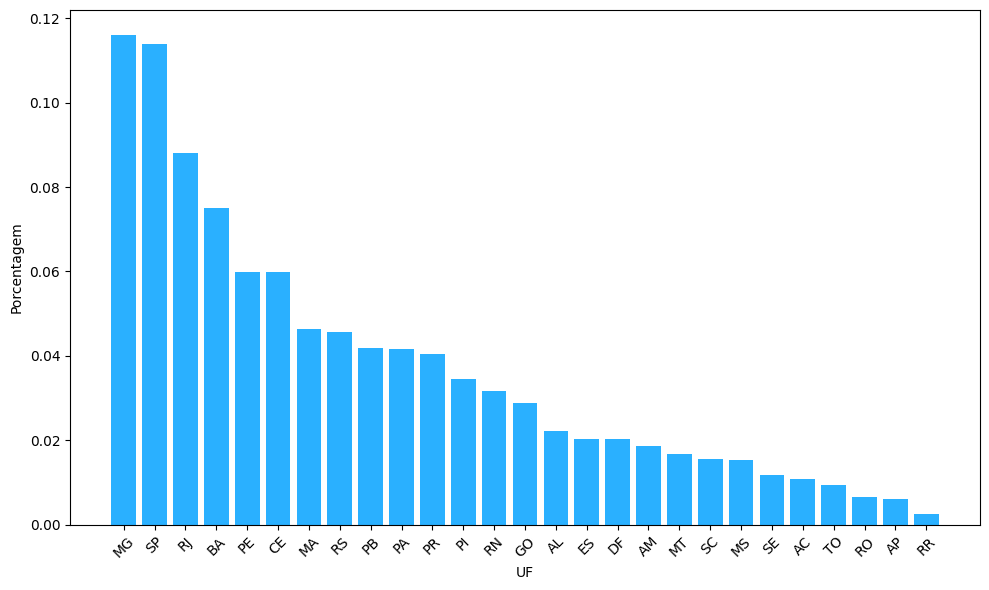

In [50]:
%matplotlib inline
estados = df_sisu["SG_UF_CANDIDATO"].value_counts().index
residencia_counts = df_sisu["SG_UF_CANDIDATO"].value_counts()
total_estados = len(df_sisu)
ies_percentages = (residencia_counts / total_estados)
plt.figure(figsize=(10, 6))
plt.bar(estados, ies_percentages, color='#2ab0ff')
plt.ylabel('Porcentagem')
plt.xlabel('UF')
#plt.title('Distribuição das inscrições por UF da instituição de ensino superior')
plt.xticks(rotation=45)
plt.savefig("distribuicao_residencia_candidatos.pdf", format="pdf", bbox_inches='tight')
plt.tight_layout()
plt.show()

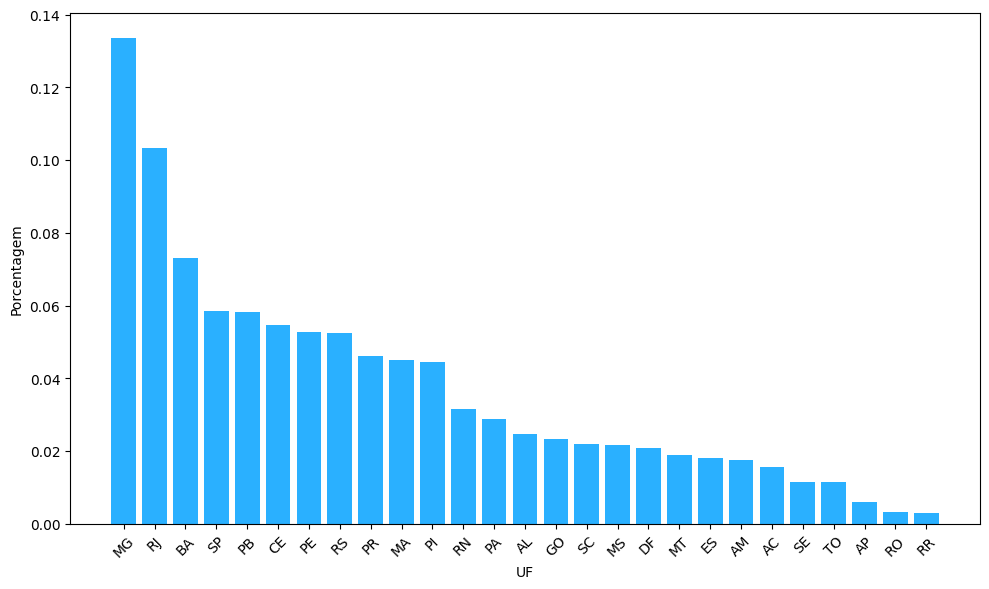

In [51]:
%matplotlib inline
estados = df_sisu["SG_UF_IES"].value_counts().index
ies_counts = df_sisu["SG_UF_IES"].value_counts()
total_estados = len(df_sisu)
ies_percentages = (ies_counts / total_estados)
plt.figure(figsize=(10, 6))
plt.bar(estados, ies_percentages, color='#2ab0ff')
plt.ylabel('Porcentagem')
plt.xlabel('UF')
#plt.title('Distribuição das inscrições por UF da instituição de ensino superior')
plt.xticks(rotation=45)
plt.savefig("distribuicao_ies.pdf", format="pdf", bbox_inches='tight')
plt.tight_layout()
plt.show()

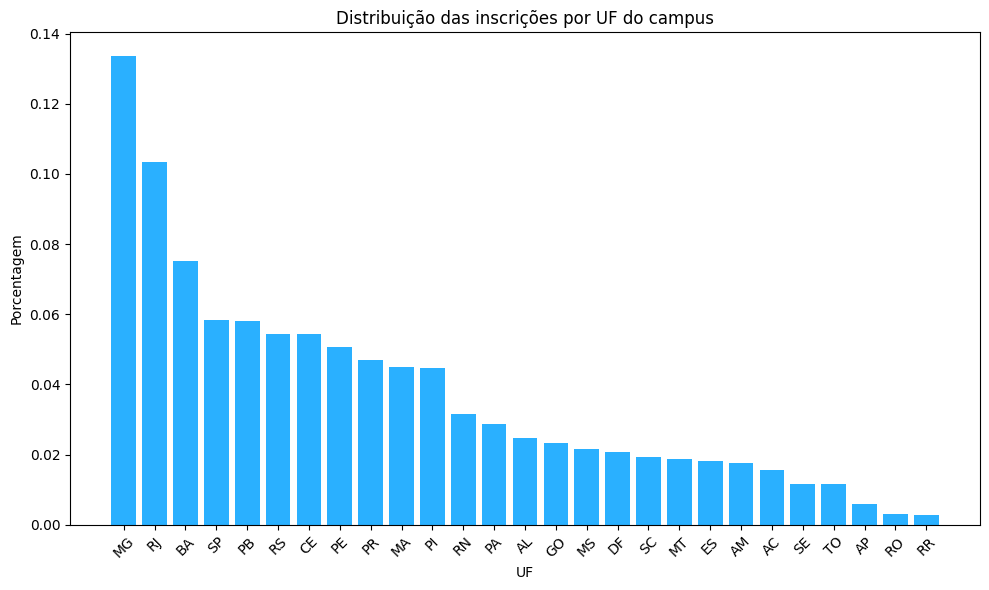

In [52]:
%matplotlib inline
estados = df_sisu["SG_UF_CAMPUS"].value_counts().index
campi_counts = df_sisu["SG_UF_CAMPUS"].value_counts()
total_estados = len(df_sisu)
campi_percentages = (campi_counts / total_estados)
plt.figure(figsize=(10, 6))
plt.bar(estados, campi_percentages, color='#2ab0ff')
plt.ylabel('Porcentagem')
plt.xlabel('UF')
plt.title('Distribuição das inscrições por UF do campus')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

● Gráfico mostrando a distribuição da UF de residência dos alunos (SG_UF_CANDIDATO) (percentual), para candidatos aprovados e não aprovados

In [53]:
uf_residencia_nao_aprovados = df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "N"]
uf_residencia_aprovados = df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "S"]

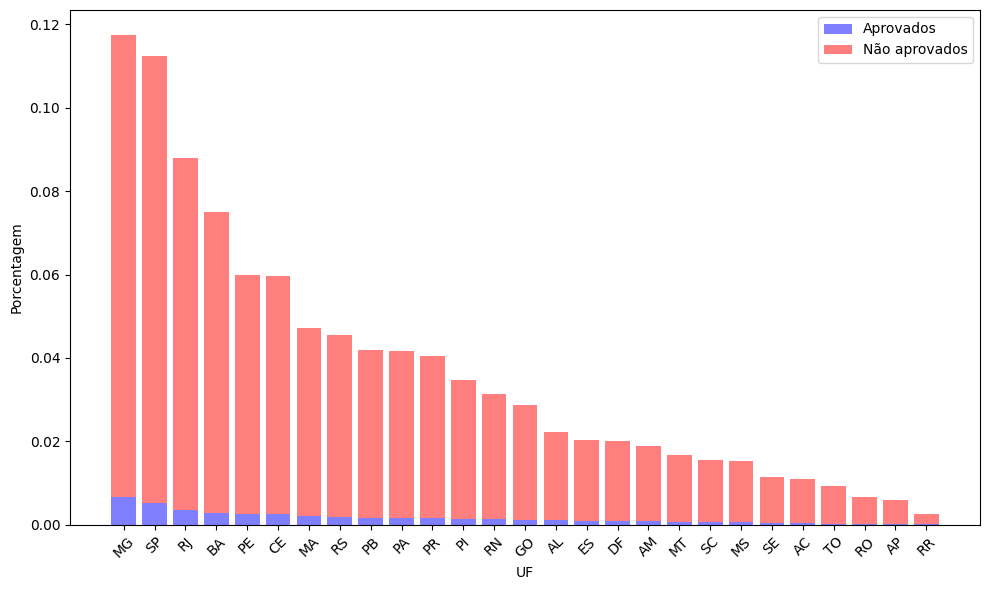

In [54]:
estados = pd.concat([df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "S"], df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "N"]], axis=0).value_counts().index
aprovados_counts = df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "S"].value_counts()
nao_aprovados_counts = df_sisu["SG_UF_CANDIDATO"][df_sisu["ST_APROVADO"] == "N"].value_counts()
total_estados = len(df_sisu)
aprovados_percentages = (aprovados_counts / total_estados)
nao_aprovados_percentages = (nao_aprovados_counts / total_estados)
plt.figure(figsize=(10, 6))
plt.bar(estados, aprovados_percentages, alpha=0.5, color='blue', label='Aprovados')
plt.bar(estados, nao_aprovados_percentages, alpha=0.5, color='red', label='Não aprovados', bottom=aprovados_percentages)
plt.ylabel('Porcentagem')
plt.xlabel('UF')
#plt.title('Distribuição da UF de residência dos alunos')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig("distribuicao_residencia.pdf", format="pdf", bbox_inches='tight')
plt.show()

● Gráfico de distribuição das notas por gênero (density plots)

In [55]:
nota_linguagens = df_sisu_sem_repeticao[["NU_NOTA_L", "TP_SEXO"]]
nota_linguagens = nota_linguagens.dropna()
nota_linguagens_masculino = nota_linguagens['NU_NOTA_L'][nota_linguagens['TP_SEXO'] == "M"]
nota_linguagens_feminino = nota_linguagens['NU_NOTA_L'][nota_linguagens['TP_SEXO'] == "F"]

In [56]:
nota_linguagens = df_sisu_sem_repeticao[["NU_NOTA_L", "ST_APROVADO"]]
nota_linguagens = nota_linguagens.dropna()
nota_linguagens_aprovados = nota_linguagens['NU_NOTA_L'][nota_linguagens['ST_APROVADO'] == "S"]
nota_linguagens_nao_aprovados = nota_linguagens['NU_NOTA_L'][nota_linguagens['ST_APROVADO'] == "N"]

In [57]:
nota_redacao = df_sisu_sem_repeticao[["NU_NOTA_R", "TP_SEXO"]]
nota_redacao = nota_redacao.dropna()
nota_redacao_masculino = nota_redacao['NU_NOTA_R'][nota_redacao['TP_SEXO'] == "M"]
nota_redacao_feminino = nota_redacao['NU_NOTA_R'][nota_redacao['TP_SEXO'] == "F"]

In [58]:
nota_redacao = df_sisu_sem_repeticao[["NU_NOTA_R", "ST_APROVADO"]]
nota_redacao = nota_redacao.dropna()
nota_redacao_aprovados = nota_redacao['NU_NOTA_R'][nota_redacao['ST_APROVADO'] == "S"]
nota_redacao_nao_aprovados = nota_redacao['NU_NOTA_R'][nota_redacao['ST_APROVADO'] == "N"]

In [59]:
nota_matematica = df_sisu_sem_repeticao[["NU_NOTA_M", "TP_SEXO"]]
nota_matematica = nota_matematica.dropna()
nota_matematica_masculino = nota_matematica['NU_NOTA_M'][nota_matematica['TP_SEXO'] == "M"]
nota_matematica_feminino = nota_matematica['NU_NOTA_M'][nota_matematica['TP_SEXO'] == "F"]

In [60]:
nota_matematica = df_sisu_sem_repeticao[["NU_NOTA_M", "ST_APROVADO"]]
nota_matematica = nota_matematica.dropna()
nota_matematica_aprovados = nota_matematica['NU_NOTA_M'][nota_matematica['ST_APROVADO'] == "S"]
nota_matematica_nao_aprovados = nota_matematica['NU_NOTA_M'][nota_matematica['ST_APROVADO'] == "N"]

In [61]:
nota_ciencias_da_natureza = df_sisu_sem_repeticao[["NU_NOTA_CN", "TP_SEXO"]]
nota_ciencias_da_natureza = nota_ciencias_da_natureza.dropna()
nota_ciencias_da_natureza_masculino = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['TP_SEXO'] == "M"]
nota_ciencias_da_natureza_feminino = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['TP_SEXO'] == "F"]

In [62]:
nota_ciencias_da_natureza = df_sisu_sem_repeticao[["NU_NOTA_CN", "ST_APROVADO"]]
nota_ciencias_da_natureza = nota_ciencias_da_natureza.dropna()
nota_ciencias_da_natureza_aprovados = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['ST_APROVADO'] == "S"]
nota_ciencias_da_natureza_nao_aprovados = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['ST_APROVADO'] == "N"]

In [63]:
nota_ciencias_humanas = df_sisu_sem_repeticao[["NU_NOTA_CH", "TP_SEXO"]]
nota_ciencias_humanas = nota_ciencias_humanas.dropna()
nota_ciencias_humanas_masculino = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['TP_SEXO'] == "M"]
nota_ciencias_humanas_feminino = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['TP_SEXO'] == "F"]

In [64]:
nota_ciencias_humanas = df_sisu_sem_repeticao[["NU_NOTA_CH", "ST_APROVADO"]]
nota_ciencias_humanas = nota_ciencias_humanas.dropna()
nota_ciencias_humanas_aprovados = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['ST_APROVADO'] == "S"]
nota_ciencias_humanas_nao_aprovados = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['ST_APROVADO'] == "N"]

○ Nota da prova de redação

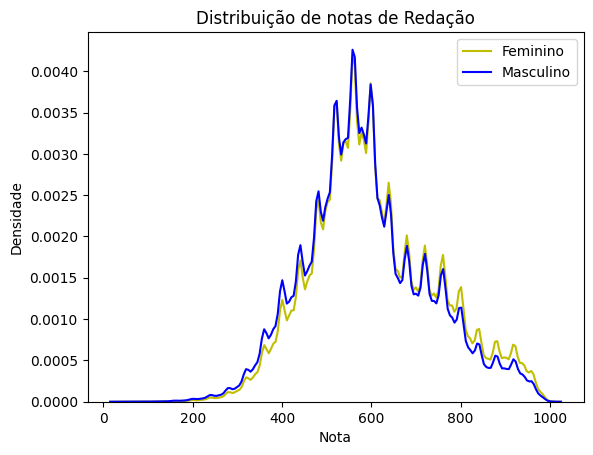

In [65]:
fig = sns.kdeplot(nota_redacao_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_redacao_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Redação")
plt.legend()
plt.show()
plt.close()

○ Nota da prova de Ciências Humanas

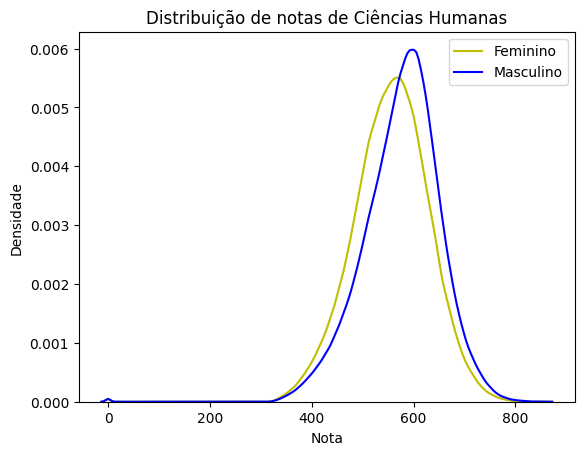

In [66]:
fig = sns.kdeplot(nota_ciencias_humanas_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_ciencias_humanas_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Ciências Humanas")
plt.legend()
plt.show()
plt.close()

○ Nota da prova de Ciências da Natureza

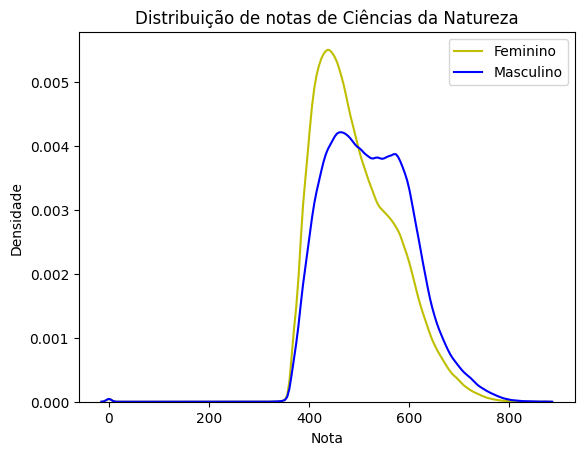

In [67]:
fig = sns.kdeplot(nota_ciencias_da_natureza_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_ciencias_da_natureza_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Ciências da Natureza")
plt.legend()
plt.show()
plt.close()

○ Nota da prova de Linguagens e Códigos

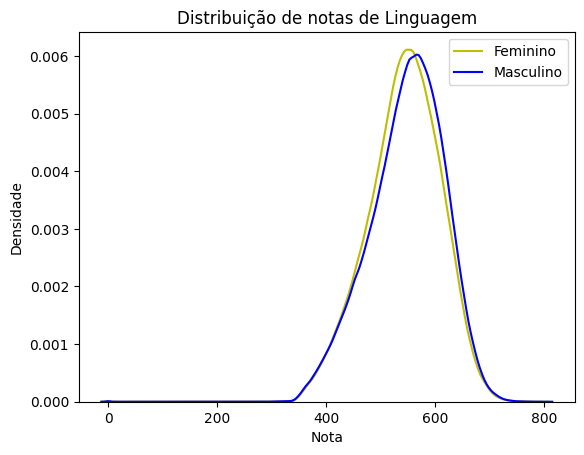

In [68]:
fig = sns.kdeplot(nota_linguagens_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_linguagens_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Linguagem")
plt.legend()
plt.show()
plt.close()

○ Nota da prova de Matemática

In [69]:
ax = sns.kdeplot(data= nota_matematica_masculino)
ax.set(xlabel='Nota Matemática', ylabel='Densidade', title = "Distribuição de notas de Matemática (masculino)")
plt.savefig('dist_mat_masc_2.jpg')
plt.close()

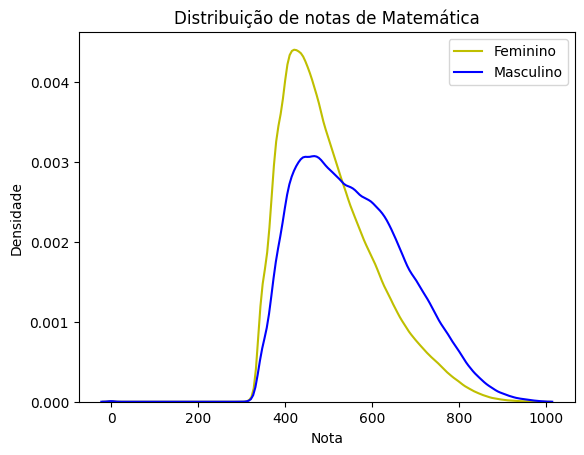

In [70]:
fig = sns.kdeplot(nota_matematica_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_matematica_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Matemática")
plt.legend()
plt.show()
plt.close()

In [71]:
from matplotlib.lines import Line2D

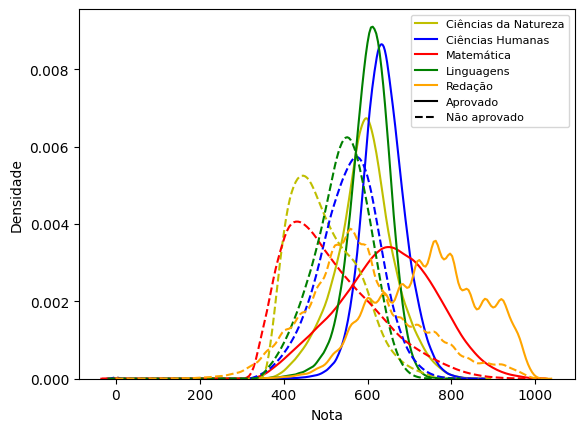

In [72]:
%matplotlib inline
fig = sns.kdeplot(nota_ciencias_da_natureza_aprovados, color="y", label = "Ciências da Natureza", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_aprovados, color="b", label = "Ciências Humanas", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_aprovados, color="r", label = "Matemática", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_aprovados, color="g", label = "Linguagens", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_aprovados, color="orange", label = "Redação", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_da_natureza_nao_aprovados, linestyle='--', color="y", label = "Ciências da Natureza m", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_nao_aprovados, linestyle='--', color="b", label = "Ciências Humanas m", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_nao_aprovados, linestyle='--', color="r", label = "Matemática m", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_nao_aprovados, linestyle='--', color="g", label = "Linguagens m", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_nao_aprovados, linestyle='--', color="orange", label = "Redação m", bw_method=0.1)
cn = Line2D([0,1],[0,1],linestyle='-', color='y')
ch = Line2D([0,1],[0,1],linestyle='-', color='b')
mtm = Line2D([0,1],[0,1],linestyle='-', color='r')
ling = Line2D([0,1],[0,1],linestyle='-', color='g')
red = Line2D([0,1],[0,1],linestyle='-', color='orange')
naprov = Line2D([0,1],[0,1],linestyle='--', color='black')
aprov = Line2D([0,1],[0,1],linestyle='-', color='black')
#fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas do gênero feminino")
fig.set(xlabel='Nota', ylabel='Densidade')
plt.legend([cn, ch, mtm, ling, red, aprov, naprov], ['Ciências da Natureza', 'Ciências Humanas', 'Matemática', 'Linguagens', 
                                                      'Redação', 'Aprovado', 'Não aprovado'], loc = 'upper right', fontsize="8")
plt.savefig("distribuicao_notas_sisu.pdf", format="pdf", bbox_inches='tight')
plt.show()

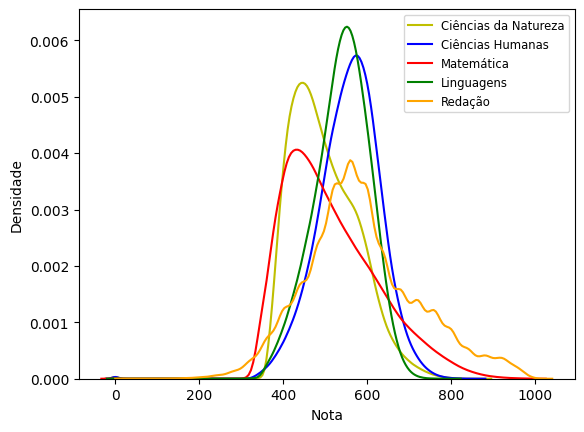

In [73]:
%matplotlib inline
fig = sns.kdeplot(nota_ciencias_da_natureza_nao_aprovados, color="y", label = "Ciências da Natureza", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_nao_aprovados, color="b", label = "Ciências Humanas", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_nao_aprovados, color="r", label = "Matemática", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_nao_aprovados, color="g", label = "Linguagens", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_nao_aprovados, color="orange", label = "Redação", bw_method=0.1)
#fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas do gênero feminino")
fig.set(xlabel='Nota', ylabel='Densidade')
plt.legend(loc = 'upper right', fontsize = 'small')
plt.savefig("distribuicao_notas_nao_aprovados.pdf", format="pdf", bbox_inches='tight')
plt.show()

Tabela com estatísticas descritivas da base de dados (média, desvio-padrão, e quantidade de observações), comparando aprovados e não aprovados

○ Grau: Percentual de cada grau

In [74]:
print(len(df_sisu[df_sisu["ST_APROVADO"] == "S"])/len(df_sisu))
print(len(df_sisu[df_sisu["ST_APROVADO"] == "N"])/len(df_sisu))

0.043364939005912484
0.9566350609940875


In [75]:
df_sisu["DS_GRAU"] = np.where(df_sisu["DS_GRAU"] == "TecnolÃ³gico", "Tecnológico", df_sisu["DS_GRAU"])
df_sisu["DS_GRAU"] = np.where(df_sisu["DS_GRAU"] == "Ãrea BÃ¡sica de Ingresso (ABI)", "Área Básica de Ingresso (ABI)", df_sisu["DS_GRAU"])

In [76]:
grau_nao_aprovados = df_sisu["DS_GRAU"][df_sisu["ST_APROVADO"] == "N"].value_counts().values
grau_aprovados = df_sisu["DS_GRAU"][df_sisu["ST_APROVADO"] == "S"].value_counts().values
total_grau_nao_aprovados = sum(grau_nao_aprovados)
total_grau_aprovados = sum(grau_aprovados)

In [77]:
arr = np.array(grau_nao_aprovados)
result = arr/total_grau_nao_aprovados
grau_nao_aprovados_percentual = result.tolist()

In [78]:
arr = np.array(grau_aprovados)
result = arr/total_grau_aprovados
grau_aprovados_percentual = result.tolist()

In [79]:
grau_rotulo = df_sisu["DS_GRAU"][df_sisu["ST_APROVADO"] == "S"].value_counts().index
grau_rotulo = grau_rotulo.tolist()

○ Turno: Percentual de cada turno (Integral, Matutino, etc)

In [80]:
turno_nao_aprovados = df_sisu["DS_TURNO"][df_sisu["ST_APROVADO"] == "N"].value_counts().values
turno_aprovados = df_sisu["DS_TURNO"][df_sisu["ST_APROVADO"] == "S"].value_counts().values
total_turno_nao_aprovados = sum(turno_nao_aprovados)
total_turno_aprovados = sum(turno_aprovados)

In [81]:
arr = np.array(turno_nao_aprovados)
result = arr/total_turno_nao_aprovados
turno_nao_aprovados_percentual = result.tolist()

In [82]:
arr = np.array(turno_aprovados)
result = arr/total_turno_aprovados
turno_aprovados_percentual = result.tolist()

In [83]:
turno_rotulo = df_sisu["DS_TURNO"][df_sisu["ST_APROVADO"] == "S"].value_counts().index
turno_rotulo = turno_rotulo.tolist()

○ Percentual de cada modalidade

In [84]:
df_sisu["DS_MOD_CONCORRENCIA"] = np.where(df_sisu["DS_MOD_CONCORRENCIA"] == "Ampla concorrÃªncia", "Ampla concorrência", df_sisu["DS_MOD_CONCORRENCIA"])

In [85]:
concorrencia_nao_aprovados = df_sisu["DS_MOD_CONCORRENCIA"][df_sisu["ST_APROVADO"] == "N"].value_counts().values
concorrencia_aprovados = df_sisu["DS_MOD_CONCORRENCIA"][df_sisu["ST_APROVADO"] == "S"].value_counts().values
ampla_concorrencia_nao_aprovados = concorrencia_nao_aprovados[0]
ampla_concorrencia_aprovados = concorrencia_aprovados[0]
acoes_afirmativas_nao_aprovados = sum(concorrencia_nao_aprovados[1:])
acoes_afirmativas_aprovados = sum(concorrencia_aprovados[1:])
total_concorrencia_nao_aprovados = concorrencia_nao_aprovados.sum()
total_concorrencia_aprovados = concorrencia_aprovados.sum()

In [86]:
ampla_concorrencia_nao_aprovados_percentual = ampla_concorrencia_nao_aprovados/total_concorrencia_nao_aprovados
ampla_concorrencia_aprovados_percentual = ampla_concorrencia_aprovados/total_concorrencia_aprovados
acoes_afirmativas_nao_aprovados_percentual = acoes_afirmativas_nao_aprovados/total_concorrencia_nao_aprovados
acoes_afirmativas_aprovados_percentual = acoes_afirmativas_aprovados/total_concorrencia_aprovados

modalidade_rotulo = ["Ampla concorrência", "Ações afirmativas"]
modalidade_aprovados_percentual = [ampla_concorrencia_aprovados_percentual, acoes_afirmativas_aprovados_percentual]
modalidade_nao_aprovados_percentual = [ampla_concorrencia_nao_aprovados_percentual, acoes_afirmativas_nao_aprovados_percentual]

○ Gênero (percentual mulheres)

In [87]:
nao_aprovados_feminino = df_sisu["TP_SEXO"][df_sisu["ST_APROVADO"] == "N"].value_counts()["F"]
nao_aprovados_masculino = df_sisu["TP_SEXO"][df_sisu["ST_APROVADO"] == "N"].value_counts()["M"]
aprovados_feminino = df_sisu["TP_SEXO"][df_sisu["ST_APROVADO"] == "S"].value_counts()["F"]
aprovado_masculino = df_sisu["TP_SEXO"][df_sisu["ST_APROVADO"] == "S"].value_counts()["M"]

total_aprovados = aprovados_feminino + aprovado_masculino
total_nao_aprovados = nao_aprovados_feminino + nao_aprovados_masculino

aprovados_feminino_percentual = aprovados_feminino/total_aprovados
aprovados_masculino_percentual = aprovado_masculino/total_aprovados
nao_aprovados_feminino_percentual = nao_aprovados_feminino/total_nao_aprovados
nao_aprovados_masculino_percentual = nao_aprovados_masculino/total_nao_aprovados

genero_rotulo = ["Feminino", "Masculino"]
genero_aprovados_percentual = [aprovados_feminino_percentual, aprovados_masculino_percentual]
genero_nao_aprovados_percentual = [nao_aprovados_feminino_percentual, nao_aprovados_masculino_percentual]

In [88]:
df_tabela_observacoes = pd.DataFrame(columns= ['Situação', 'Variável', 'Descrição', 'Valor'])
for i in range(len(grau_rotulo)):
    row1 = {"Situação" : "Aprovado", "Variável" : "Grau", "Descrição" : grau_rotulo[i], "Valor" : grau_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovado", "Variável" : "Grau", "Descrição" : grau_rotulo[i], "Valor" : grau_nao_aprovados_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(turno_rotulo)):
    row1 = {"Situação" : "Aprovado", "Variável" : "Turno", "Descrição" : turno_rotulo[i], "Valor" : turno_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovado", "Variável" : "Turno", "Descrição" : turno_rotulo[i], "Valor" : turno_nao_aprovados_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(modalidade_rotulo)):
    row1 = {"Situação" : "Aprovado", "Variável" : "Modalidade", "Descrição" : modalidade_rotulo[i], "Valor" : modalidade_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovado", "Variável" : "Modalidade", "Descrição" : modalidade_rotulo[i], "Valor" : modalidade_nao_aprovados_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(genero_rotulo)):
    row1 = {"Situação" : "Aprovado", "Variável" : "Gênero", "Descrição" : genero_rotulo[i], "Valor" : genero_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovado", "Variável" : "Gênero", "Descrição" : genero_rotulo[i], "Valor" : genero_nao_aprovados_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

C:\Users\sacer\AppData\Local\Temp\ipykernel_2844\4262648756.py:5: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])


In [89]:
df_tabela_observacoes_pivot = df_tabela_observacoes.pivot(values= 'Valor', 
                                index=['Variável', 'Descrição'], 
                                columns=['Situação'])
df_tabela_observacoes_pivot_formatado = df_tabela_observacoes_pivot.style.format('{:,.2%}')
df_tabela_observacoes_pivot_formatado.set_caption("Tabulação de estatísticas de aprovados e não aprovados")
display(df_tabela_observacoes_pivot_formatado)

○ Nota da prova de Linguagens e Códigos

In [90]:
nota_linguagens_nao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_L"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_linguagens_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_L"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])
nota_linguagens_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_L"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_linguagens_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_L"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])

In [91]:
intervalos = [0, 200, 400, 600, 800, 1000]

nota_linguagens = df_sisu_sem_repeticao[["NU_NOTA_L", "ST_APROVADO"]]
nota_linguagens = nota_linguagens.dropna()
nota_linguagens_aprovados = nota_linguagens['NU_NOTA_L'][nota_linguagens['ST_APROVADO'] == "S"]
nota_linguagens_nao_aprovados = nota_linguagens['NU_NOTA_L'][nota_linguagens['ST_APROVADO'] == "N"]

contagem_nota_linguagens_aprovados = pd.cut(nota_linguagens_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_linguagens_aprovados = len(nota_linguagens_aprovados)
lista_contagem_nota_linguagens_aprovados_percentual = (contagem_nota_linguagens_aprovados / total_nota_linguagens_aprovados).tolist()

contagem_nota_linguagens_nao_aprovados = pd.cut(nota_linguagens_nao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_linguagens_nao_aprovados = len(nota_linguagens_nao_aprovados)
lista_contagem_nota_linguagens_nao_aprovados_percentual = (contagem_nota_linguagens_nao_aprovados / total_nota_linguagens_nao_aprovados).tolist()

○ Nota da prova de Ciências Humanas

In [92]:
nota_ciencias_humanas_nao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_CH"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_ciencias_humanas_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_CH"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])
nota_ciencias_humanas_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_CH"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_ciencias_humanas_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_CH"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])

In [93]:
nota_ciencias_humanas = df_sisu_sem_repeticao[["NU_NOTA_CH", "ST_APROVADO"]]
nota_ciencias_humanas = nota_ciencias_humanas.dropna()
nota_ciencias_humanas_aprovados = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['ST_APROVADO'] == "S"]
nota_ciencias_humanas_nao_aprovados = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['ST_APROVADO'] == "N"]

contagem_nota_ciencias_humanas_aprovados = pd.cut(nota_ciencias_humanas_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_ciencias_humanas_aprovados = len(nota_ciencias_humanas_aprovados)
lista_contagem_nota_ciencias_humanas_aprovados_percentual = (contagem_nota_ciencias_humanas_aprovados / total_nota_ciencias_humanas_aprovados).tolist()

contagem_nota_ciencias_humanas_nao_aprovados = pd.cut(nota_ciencias_humanas_nao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_ciencias_humanas_nao_aprovados = len(nota_ciencias_humanas_nao_aprovados)
lista_contagem_nota_ciencias_humanas_nao_aprovados_percentual = (contagem_nota_ciencias_humanas_nao_aprovados / total_nota_ciencias_humanas_nao_aprovados).tolist()

○ Nota da prova de Ciências da Natureza

In [94]:
nota_ciencias_da_natureza_nao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_CN"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_ciencias_da_natureza_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_CN"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])
nota_ciencias_da_natureza_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_CN"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_ciencias_da_natureza_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_CN"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])

In [95]:
nota_ciencias_da_natureza = df_sisu_sem_repeticao[["NU_NOTA_CN", "ST_APROVADO"]]
nota_ciencias_da_natureza = nota_ciencias_da_natureza.dropna()
nota_ciencias_da_natureza_aprovados = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['ST_APROVADO'] == "S"]
nota_ciencias_da_natureza_nao_aprovados = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['ST_APROVADO'] == "N"]

contagem_nota_ciencias_da_natureza_aprovados = pd.cut(nota_ciencias_da_natureza_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_ciencias_da_natureza_aprovados = len(nota_ciencias_da_natureza_aprovados)
lista_contagem_nota_ciencias_da_natureza_aprovados_percentual = (contagem_nota_ciencias_da_natureza_aprovados / total_nota_ciencias_da_natureza_aprovados).tolist()

contagem_nota_ciencias_da_natureza_nao_aprovados = pd.cut(nota_ciencias_da_natureza_nao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_ciencias_da_natureza_nao_aprovados = len(nota_ciencias_da_natureza_nao_aprovados)
lista_contagem_nota_ciencias_da_natureza_nao_aprovados_percentual = (contagem_nota_ciencias_da_natureza_nao_aprovados / total_nota_ciencias_da_natureza_nao_aprovados).tolist()

In [ ]:
print(len(df_sisu_sem_repeticao[df_sisu_sem_repeticao["ST_APROVADO"] == "N"]))
print(len(df_sisu_sem_repeticao[df_sisu_sem_repeticao["ST_APROVADO"] == "S"]))


○ Nota da prova de Matemática

In [ ]:
nota_matematica_nao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_M"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_matematica_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_M"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])
nota_matematica_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_M"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_matematica_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_M"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])

In [ ]:
nota_matematica = df_sisu_sem_repeticao[["NU_NOTA_M", "ST_APROVADO"]]
nota_matematica = nota_matematica.dropna()
nota_matematica_aprovados = nota_matematica['NU_NOTA_M'][nota_matematica['ST_APROVADO'] == "S"]
nota_matematica_nao_aprovados = nota_matematica['NU_NOTA_M'][nota_matematica['ST_APROVADO'] == "N"]

contagem_nota_matematica_aprovados = pd.cut(nota_matematica_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_matematica_aprovados = len(nota_matematica_aprovados)
lista_contagem_nota_matematica_aprovados_percentual = (contagem_nota_matematica_aprovados / total_nota_matematica_aprovados).tolist()

contagem_nota_matematica_nao_aprovados = pd.cut(nota_matematica_nao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_matematica_nao_aprovados = len(nota_matematica_nao_aprovados)
lista_contagem_nota_matematica_nao_aprovados_percentual = (contagem_nota_matematica_nao_aprovados / total_nota_matematica_nao_aprovados).tolist()

○ Nota da prova de Redação

In [ ]:
nota_redacao_nao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_R"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_redacao_aprovados_media = np.average(df_sisu_sem_repeticao["NU_NOTA_R"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])
nota_redacao_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_R"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"])
nota_redacao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["NU_NOTA_R"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"])

In [ ]:
nota_redacao = df_sisu_sem_repeticao[["NU_NOTA_R", "ST_APROVADO"]]
nota_redacao = nota_redacao.dropna()
nota_redacao_aprovados = nota_redacao['NU_NOTA_R'][nota_redacao['ST_APROVADO'] == "S"]
nota_redacao_nao_aprovados = nota_redacao['NU_NOTA_R'][nota_redacao['ST_APROVADO'] == "N"]

contagem_nota_redacao_aprovados = pd.cut(nota_redacao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_redacao_aprovados = len(nota_redacao_aprovados)
lista_contagem_nota_redacao_aprovados_percentual = (contagem_nota_redacao_aprovados / total_nota_redacao_aprovados).tolist()

contagem_nota_redacao_nao_aprovados = pd.cut(nota_redacao_nao_aprovados, bins=intervalos, right=True, include_lowest=True).value_counts().sort_index()
total_nota_redacao_nao_aprovados = len(nota_redacao_nao_aprovados)
lista_contagem_nota_redacao_nao_aprovados_percentual = (contagem_nota_redacao_nao_aprovados / total_nota_redacao_nao_aprovados).tolist()

○ Idade

In [ ]:
idade_nao_aprovados_media = np.average(df_sisu_sem_repeticao["IDADE"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"].dropna())
idade_aprovados_media = np.average(df_sisu_sem_repeticao["IDADE"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"].dropna())
idade_nao_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["IDADE"][df_sisu_sem_repeticao["ST_APROVADO"] == "N"].dropna())
idade_aprovados_desvio_padrao = np.std(df_sisu_sem_repeticao["IDADE"][df_sisu_sem_repeticao["ST_APROVADO"] == "S"].dropna())

In [ ]:
df_tabela_estatisticas = pd.DataFrame(columns = ['Situação', 'Estatística', 'Variável', 'Valor'])
row1 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Idade", "Valor" : idade_aprovados_media}
row2 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Idade", "Valor" : idade_nao_aprovados_media}
row3 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Idade", "Valor" : idade_aprovados_desvio_padrao}
row4 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Idade", "Valor" : idade_nao_aprovados_desvio_padrao}

row5 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_aprovados_media}
row6 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_nao_aprovados_media}
row7 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_aprovados_desvio_padrao}
row8 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_nao_aprovados_desvio_padrao}

row9 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_aprovados_media}
row10 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_nao_aprovados_media}
row11 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_aprovados_desvio_padrao}
row12 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_nao_aprovados_desvio_padrao}

row13 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Nota Matemática", "Valor" : nota_matematica_aprovados_media}
row14 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Nota Matemática", "Valor" : nota_matematica_nao_aprovados_media}
row15 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Matemática", "Valor" : nota_matematica_aprovados_desvio_padrao}
row16 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Matemática", "Valor" : nota_matematica_nao_aprovados_desvio_padrao}

row17 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_aprovados_media}
row18 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_nao_aprovados_media}
row19 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_aprovados_desvio_padrao}
row20 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_nao_aprovados_desvio_padrao}

row21 = {"Situação" : "Aprovado", "Estatística" : "Média", "Variável" : "Nota Redação", "Valor" : nota_redacao_aprovados_media}
row22 = {"Situação" : "Não aprovado", "Estatística" : "Média", "Variável" : "Nota Redação", "Valor" : nota_redacao_nao_aprovados_media}
row23 = {"Situação" : "Aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Redação", "Valor" : nota_redacao_aprovados_desvio_padrao}
row24 = {"Situação" : "Não aprovado", "Estatística" : "Desvio padrão", "Variável" : "Nota Redação", "Valor" : nota_redacao_nao_aprovados_desvio_padrao}



df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row1])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row2])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row3])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row4])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row5])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row6])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row7])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row8])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row9])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row10])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row11])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row12])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row13])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row14])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row15])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row16])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row17])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row18])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row19])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row20])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row21])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row22])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row23])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row24])])

In [ ]:
df_tabela_estatisticas_pivot = pd.pivot_table(df_tabela_estatisticas, values= 'Valor', 
                                index=[ 'Variável'], 
                                columns=['Situação','Estatística'], 
                                aggfunc=np.mean,
                                fill_value=0)
df_tabela_estatisticas_pivot_formatado = df_tabela_estatisticas_pivot.style.set_caption("Tabulação de estatísticas")
df_tabela_estatisticas_pivot_formatado.format('{:,.2f}')
display(df_tabela_estatisticas_pivot_formatado)

○ Observações das notas das provas

In [ ]:
nota_intervalos = ["(0, 200]","(200, 400]","(400, 600]","(600, 800]","(800, 1000]"]

df_tabela_observacoes_nota = pd.DataFrame(columns= ['Situação', 'Prova', 'Intervalo', 'Valor'])
for i in range(len(nota_intervalos)):
    row1 = {"Situação" : "Aprovados", "Prova" : "Ciências Humanas", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_ciencias_humanas_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovados", "Prova" : "Ciências Humanas", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_ciencias_humanas_nao_aprovados_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Situação" : "Aprovados", "Prova" : "Ciências da Natureza", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_ciencias_da_natureza_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovados", "Prova" : "Ciências da Natureza", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_ciencias_da_natureza_nao_aprovados_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Situação" : "Aprovados", "Prova" : "Linguagens", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_linguagens_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovados", "Prova" : "Linguagens", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_linguagens_nao_aprovados_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Situação" : "Aprovados", "Prova" : "Matemática", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_matematica_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovados", "Prova" : "Matemática", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_matematica_nao_aprovados_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Situação" : "Aprovados", "Prova" : "Redação", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_redacao_aprovados_percentual[i]}
    row2 = {"Situação" : "Não aprovados", "Prova" : "Redação", "Intervalo" : nota_intervalos[i], "Valor" : lista_contagem_nota_redacao_nao_aprovados_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

In [ ]:
df_tabela_observacoes_nota_pivot = df_tabela_observacoes_nota.pivot(values= ['Valor'], 
                                index=['Intervalo'], 
                                columns=['Prova', 'Situação'])
df_tabela_observacoes_nota_pivot_formatado = df_tabela_observacoes_nota_pivot.style.format("{:.2%}")
df_tabela_observacoes_nota_pivot_formatado.set_caption("Tabulação de observações de notas")
display(df_tabela_observacoes_nota_pivot_formatado)

○ Idade

In [ ]:
intervalos = [10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90]
categorias_idade = pd.cut(df_sisu_sem_repeticao['IDADE'], bins=intervalos, right=False)
df_resultado = pd.DataFrame(index=categorias_idade.cat.categories.astype(str))
df_resultado["Quantidade"] = categorias_idade.value_counts().sort_index().values
df_resultado["Porcentagem"] = (df_resultado["Quantidade"] / df_resultado["Quantidade"].sum()) 
df_resultado["Porcentagem"] = df_resultado["Porcentagem"].apply(lambda x: "{:.2%}".format(x))
styled_df = df_resultado.style.set_caption("Tabulação de Idades")
display(styled_df)

,Quantidade,Porcentagem
"[10, 15)",50,0.00%
"[15, 20)",1430113,49.56%
"[20, 25)",807947,28.00%
"[25, 30)",291627,10.11%
"[30, 35)",151306,5.24%
"[35, 40)",89465,3.10%
"[40, 45)",52550,1.82%
"[45, 50)",32275,1.12%
"[50, 55)",18663,0.65%
"[55, 60)",7937,0.28%


In [ ]:
disciplinas = ["NU_NOTA_M", "NU_NOTA_R", "NU_NOTA_CH", "NU_NOTA_CN", "NU_NOTA_L"]

resultados = {"Estatística": ["Matemática", "Redação", "Ciências Humanas", "Ciências da Natureza", "Linguagens", "Idade"], "Estatística t": [], "P-valor": []}

nivel_significancia = 0.05

for disciplina in disciplinas:
    notas_aprovados = df_sisu_sem_repeticao[df_sisu_sem_repeticao['ST_APROVADO'] == "S"][disciplina]
    notas_nao_aprovados = df_sisu_sem_repeticao[df_sisu_sem_repeticao['ST_APROVADO'] == "N"][disciplina]
    
    desvio_padrao_aprovados = notas_aprovados.std()
    desvio_padrao_nao_aprovados = notas_nao_aprovados.std()
    
    t_statistic, p_value = stats.ttest_ind(notas_aprovados, notas_nao_aprovados, equal_var=False)
    print(p_value)
    resultados["Estatística t"].append(t_statistic)
    resultados["P-valor"].append(p_value)

idade_aprovados = df_sisu_sem_repeticao[df_sisu_sem_repeticao['ST_APROVADO'] == "S"]["IDADE"]
idade_nao_aprovados = df_sisu_sem_repeticao[df_sisu_sem_repeticao['ST_APROVADO'] == "N"]["IDADE"]
desvio_padrao_aprovados = idade_aprovados.std()
desvio_padrao_nao_aprovados = idade_nao_aprovados.std()
t_statistic_1, p_value_1 = stats.ttest_ind(idade_aprovados, idade_nao_aprovados, equal_var=False)
resultados["Estatística t"].append(t_statistic_1)
resultados["P-valor"].append(p_value_1)

resultados_df = pd.DataFrame(resultados)
resultados_df_formatado = resultados_df.style.hide()
resultados_df_formatado.set_caption("Teste-t de Student")
display(resultados_df_formatado)

0.0
0.0
0.0
0.0
0.0


Estatística,Estatística t,P-valor
Matemática,567.984107,0.000000
Redação,650.581358,0.000000
Ciências Humanas,752.496159,0.000000
Ciências da Natureza,666.509123,0.000000
Linguagens,645.042674,0.000000
Idade,-137.005561,0.000000


In [ ]:
df_sisu.columns

Index(['NU_ANO', 'NU_EDICAO', 'CO_ETAPA', 'CO_IES', 'NO_IES', 'SIGLA_IES',
       'SG_UF_IES', 'CO_CAMPUS', 'NO_CAMPUS', 'SG_UF_CAMPUS',
       'NO_MUNUCIPIO_CAMPUS', 'CO_IES_CURSO', 'NO_CURSO', 'DS_GRAU',
       'DS_TURNO', 'TP_MOD_CONCORRENCIA', 'DS_MOD_CONCORRENCIA',
       'NU_PERCENTUAL_BONUS', 'NU_PESO_L', 'NU_PESO_CH', 'NU_PESO_CN',
       'NU_PESO_M', 'NU_PESO_R', 'NOTA_MINIMA_L', 'NOTA_MINIMA_CH',
       'NOTA_MINIMA_CN', 'NOTA_MINIMA_M', 'NOTA_MINIMA_R', 'MEDIA_MINIMA',
       'NU_CPF', 'CO_INSCRICAO_ENEM', 'NO_INSCRITO', 'TP_SEXO',
       'DT_NASCIMENTO', 'SG_UF_CANDIDATO', 'MUNICIPIO_CANDIDATO', 'ST_OPCAO',
       'NU_NOTA_L', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_M', 'NU_NOTA_R',
       'NOTA_L_COM_PESO', 'NOTA_CH_COM_PESO', 'NOTA_CN_COM_PESO',
       'NOTA_M_COM_PESO', 'NOTA_R_COM_PESO', 'NU_NOTA_CANDIDATO',
       'NU_NOTACORTE', 'NU_CLASSIFICACAO', 'ST_APROVADO', 'LISTAGEM',
       'DATA_NASCIMENTO_CONVERTIDA', 'IDADE', 'CD_CLASSIFICACAO', 'AREA_GERAL',
       'NOTAS_CON

In [ ]:
agg_funcs = {
    'NO_INSCRITO': 'first',
    'IDADE': 'first',
    'TP_SEXO': 'first',
    'SG_UF_CANDIDATO': 'first',
    'MUNICIPIO_CANDIDATO': 'first',
    'NU_NOTA_L': 'first',
    'NU_NOTA_CH': 'first',
    'NU_NOTA_CN': 'first',
    'NU_NOTA_M': 'first',
    'NU_NOTA_R': 'first',
    'CO_IES': lambda x: list(x),
    'NO_IES': lambda x: list(x),
    'SIGLA_IES': lambda x: list(x),
    'SG_UF_IES': lambda x: list(x),
    'CO_CAMPUS': lambda x: list(x),
    'NO_CAMPUS': lambda x: list(x),
    'SG_UF_CAMPUS': lambda x: list(x),
    'NO_MUNUCIPIO_CAMPUS': lambda x: list(x),
    'CO_IES_CURSO': lambda x: list(x),
    'NO_CURSO': lambda x: list(x),
    'DS_GRAU': lambda x: list(x),
    'DS_TURNO': lambda x: list(x),
    'TP_MOD_CONCORRENCIA': lambda x: list(x),
    'DS_MOD_CONCORRENCIA': lambda x: list(x),
    'NU_NOTA_CANDIDATO': lambda x: list(x),
    'NU_NOTACORTE': lambda x: list(x),
    'NU_CLASSIFICACAO': lambda x: list(x),
    'ST_APROVADO': lambda x: list(x),
    'LISTAGEM': lambda x: list(x),
    'CD_CLASSIFICACAO': lambda x: list(x),
}
df_resumido = df_sisu.groupby(['IDENTIFICADORES_CONCATENADOS', 'NOTAS_CONCATENADAS']).agg(agg_funcs).reset_index()

In [ ]:
df_resumido.to_parquet("SISU_2017_resumido.parquet")

In [ ]:
tamanho_antes = len(df_sisu)
tamanho_depois = len(df_resumido)
porcentagem_reducao = ((tamanho_antes - tamanho_depois) / tamanho_antes) * 100

print(f"Redução do dataset SISU 2017 (remoção de duplicatas): {porcentagem_reducao:.2f}% \n Antes: {tamanho_antes} registros \n Depois: {tamanho_depois} registros")

Redução do dataset SISU 2017 (remoção de duplicatas): 60.62% 
 Antes: 6665892 registros 
 Depois: 2625229 registros
